In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from os.path import join as opj # For creating and combining paths

# GLM functions
from nilearn.glm.first_level import make_first_level_design_matrix
from nilearn.glm.first_level import FirstLevelModel

# IO functions
from nilearn.image import load_img, new_img_like

# Masking/ROI functions
from nilearn.maskers import NiftiLabelsMasker


# Plotting functions
from nilearn.plotting import plot_design_matrix, plot_stat_map, plot_glass_brain, plot_roi, view_img_on_surf, view_img

In [2]:
data_root = 'D:/HCP_data'
subjects_dir = opj(data_root, 'Subjects')

bold_LR_subdir = 'MNINonLinear/Results/tfMRI_SOCIAL_LR/tfMRI_SOCIAL_LR.nii.gz'
events_MENTAL_LR_subdir = 'MNINonLinear/Results/tfMRI_SOCIAL_LR/EVs/mental.txt'
events_RANDOM_LR_subdir = 'MNINonLinear/Results/tfMRI_SOCIAL_LR/EVs/rnd.txt'

bold_RL_subdir = 'MNINonLinear/Results/tfMRI_SOCIAL_RL/tfMRI_SOCIAL_RL.nii.gz'
events_MENTAL_RL_subdir = 'MNINonLinear/Results/tfMRI_SOCIAL_RL/EVs/mental.txt'
events_RANDOM_RL_subdir = 'MNINonLinear/Results/tfMRI_SOCIAL_RL/EVs/rnd.txt'

glasser_parcellation_file = 'Atlas/glasser_MNI152NLin6Asym_labels_p20.nii.gz'
glasser_labels_file = 'Atlas/glasser_labels.txt'

Custom functions

In [3]:
# Get list of subjects from folders in the subjects directory
def get_subject_list(subjects_dir):
    return os.listdir(subjects_dir)

# Loach a EV file
def load_events(file, trial_type):
    df = pd.read_csv(file, sep='\t', header=None)
    df.columns = ['onset', 'duration', 'amplitude']
    df['trial_type'] = trial_type
    df.drop(columns=['amplitude'], inplace=True)
    return df

# Combine two loaded EVs into one
def combine_events(events_df_1, events_df_2):
    combined_df = pd.concat([events_df_1, events_df_2], ignore_index=True)
    combined_df.sort_values(by='onset', inplace=True)
    return combined_df

# Save results of the contrast so we don't have to recompute thjem bc it takes a while
def save_all_contrasts(output_path, contrasts):
    os.makedirs(output_path, exist_ok=True)
    for sub in contrasts:
        for dir in contrasts[sub]:
            for res in contrasts[sub][dir]:
                filename = '_'.join([sub, dir, res.replace('_', '')])
                filepath = opj(output_path, filename)
                print(f'Saving contrast to {filepath}...')
                contrasts[sub][dir][res].to_filename(filepath)
    return output_path

# Save design matrix for each subject for checking
def save_all_designs(output_path, matrices):
    os.makedirs(output_path, exist_ok=True)
    for sub in matrices:
        for dir in matrices[sub]:
            dm = matrices[sub][dir]
            filename = '_'.join([sub, dir, 'design.png'])
            filepath = opj(output_path, filename)
            fig, ax = plt.subplots(1,1,figsize=(5,5))
            #ax.set_title(f'Design matrix for subject {sub}, run {dir}')
            plot_design_matrix(dm, axes=ax, output_file=filepath)
    return output_path

# Load saved contrast files
def load_all_contrasts(contrast_dir, ext='.nii'):
    contrasts = {}
    files = [f for f in os.listdir(contrast_dir) if f.endswith(ext)]
    count = 0
    for f in files:
        count += 1
        print(f'Loading file {count}/{len(files)}...')
        sub = f.split('_')[0].split('.')[0]
        direction = f.split('_')[1].split('.')[0]
        stat = f.split('_')[2].split('.')[0]
        
        img = load_img(opj(contrast_dir, f))
        if sub not in contrasts:
            contrasts[sub] = {}
        if direction not in contrasts[sub]:
            contrasts[sub][direction] = {}
        
        contrasts[sub][direction][stat] = img
        
    return contrasts

# Generate image for the contrasts
# img_type can be zscore, stat, pvalue, effect or effectvariance
# for z-score, threshold can be 2 or 3
def plot_first_level_contrast(contrasts, img_type, threshold):
    cols = 2
    rows = len(contrasts)
    fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(6, 400))
    
    row_idx = 0
    col_idx = 0
    for sub in contrasts:
        for direction in contrasts[sub]:
            plot_glass_brain(
                contrasts[sub][direction][img_type],
                axes = axes[row_idx, col_idx],
                display_mode="z",
                threshold=threshold,
                plot_abs=False,
                colorbar=False,
                title=f'{sub}_{direction}'
            )
            col_idx += 1
        row_idx += 1
        col_idx = 0

First level analysis (will take a couple of hours)

In [ ]:
subject_list = get_subject_list(subjects_dir)

# Parameters for GLM
SMOOTHING_FWHM = 4          # Spatial smoothing
HRF_MODEL = "spm"           # Hemodynamic response function model (can also be 'glober', etc)
DRIFT_MODEL = "polynomial"  # Low frequency noise model
DRIFT_ORDER = 1             # Degree of the noise model
HIGH_PASS = 0.01            # High-pass filter cutoff frequency
DURATION_TR = 274           # Number of volumes/images/timepoints per run
TR = 0.72                   # Repetition time in seconds
CONTRAST = [[1, -1, 0, 0]]  # Mental vs Random contrast

FRAME_TIMES = np.arange(DURATION_TR)   

# Initialize dictionaries to store results. The structure will be as follows:
# dictionary = { 'subject': {'LR': {stat: <nilearn_object>}, ...} }
all_design_matrices = {}
all_contrast_results = {}

# Iterate over subjects
count = 0
for subj in subject_list:
    count += 1
    print(f'Processing subject {subj} ({count}/{len(subject_list)})...')


    # Load BOLD data for each run
    subj_bold_LR_file = opj(subjects_dir, subj, bold_LR_subdir)
    subj_bold_RL_file = opj(subjects_dir, subj, bold_RL_subdir)

    # Load events data for each run
    subj_events_MENTAL_LR = load_events(opj(subjects_dir, subj, events_MENTAL_LR_subdir), 'mental')
    subj_events_RANDOM_LR = load_events(opj(subjects_dir, subj, events_RANDOM_LR_subdir), 'random')
    subj_events_LR = combine_events(subj_events_MENTAL_LR, subj_events_RANDOM_LR)
    subj_events_MENTAL_RL = load_events(opj(subjects_dir, subj, events_MENTAL_RL_subdir), 'mental')
    subj_events_RANDOM_RL = load_events(opj(subjects_dir, subj, events_RANDOM_RL_subdir), 'random')
    subj_events_RL = combine_events(subj_events_MENTAL_RL, subj_events_RANDOM_RL)

    # Make design matrix for each run
    subj_design_matrix_LR = make_first_level_design_matrix(
        FRAME_TIMES,
        subj_events_LR,
        drift_model=DRIFT_MODEL,
        drift_order=DRIFT_ORDER,
        hrf_model=HRF_MODEL,
    )
    subj_design_matrix_RL = make_first_level_design_matrix(
        FRAME_TIMES,
        subj_events_RL,
        drift_model=DRIFT_MODEL,
        drift_order=DRIFT_ORDER,
        hrf_model=HRF_MODEL,
    )

    # Generate and fit the GLM for each run
    print('\tFitting GLM for LR run...')
    subj_glm_LR = FirstLevelModel(
        smoothing_fwhm=SMOOTHING_FWHM,
        signal_scaling=(0, 1),
    ).fit(subj_bold_LR_file, design_matrices=subj_design_matrix_LR)
    print('\tFitting GLM for RL run...')
    subj_glm_RL = FirstLevelModel(
        smoothing_fwhm=SMOOTHING_FWHM,
        signal_scaling=(0, 1),
    ).fit(subj_bold_RL_file, design_matrices=subj_design_matrix_RL)

    # Compute contrasts (Mantal Vs. Random) for each run
    print('\tComputing Mental vs Random contrasts...')
    subj_contrast_MENTALvsRANDOM_LR = subj_glm_LR.compute_contrast(CONTRAST, output_type='all')
    subj_contrast_MENTALvsRANDOM_RL = subj_glm_RL.compute_contrast(CONTRAST, output_type='all')

    print('\tCollating data...')

    # Store results in dictionaries
    subj_contrast_results = {
        'LR': subj_contrast_MENTALvsRANDOM_LR,
        'RL': subj_contrast_MENTALvsRANDOM_RL
    }
    subj_design_matrices = {
        'LR': subj_design_matrix_LR,
        'RL': subj_design_matrix_RL
    }
    all_design_matrices[subj] = subj_design_matrices
    all_contrast_results[subj] = subj_contrast_results

    print('\tFinished!')

print('All subjects processed!')

save_all_contrasts('GLM_nilearn/1st_level/contrasts_MentalVsRandom/grand_mean_scaling', all_contrast_results)
#save_all_designs('GLM_nilearn/1st_level/design_matrices', all_design_matrices)

Processing subject 100307 (1/100)...
	Fitting GLM for LR run...
	Fitting GLM for RL run...
	Computing Mental vs Random contrasts...
	Collating data...
	Finished!
Processing subject 100408 (3/100)...
	Fitting GLM for LR run...
	Fitting GLM for RL run...
	Computing Mental vs Random contrasts...
	Collating data...
	Finished!
Processing subject 101107 (5/100)...
	Fitting GLM for LR run...
	Fitting GLM for RL run...
	Computing Mental vs Random contrasts...
	Collating data...
	Finished!
Processing subject 101309 (7/100)...
	Fitting GLM for LR run...
	Fitting GLM for RL run...
	Computing Mental vs Random contrasts...
	Collating data...
	Finished!
Processing subject 101915 (9/100)...
	Fitting GLM for LR run...
	Fitting GLM for RL run...
	Computing Mental vs Random contrasts...
	Collating data...
	Finished!
Processing subject 103111 (11/100)...
	Fitting GLM for LR run...
	Fitting GLM for RL run...
	Computing Mental vs Random contrasts...
	Collating data...
	Finished!
Processing subject 103414 (

'GLM_nilearn/1st_level/contrasts_MentalVsRandom/grand_mean_scaling'

Load the pre-computed contrasts so we don't have to compute them again

In [ ]:
all_contrasts = load_all_contrasts('GLM_nilearn/1st_level/contrasts_MentalVsRandom/grand_mean_scaling')

Loading file 1/1000...
Loading file 2/1000...
Loading file 3/1000...
Loading file 4/1000...
Loading file 5/1000...
Loading file 6/1000...
Loading file 7/1000...
Loading file 8/1000...
Loading file 9/1000...
Loading file 10/1000...
Loading file 11/1000...
Loading file 12/1000...
Loading file 13/1000...
Loading file 14/1000...
Loading file 15/1000...
Loading file 16/1000...
Loading file 17/1000...
Loading file 18/1000...
Loading file 19/1000...
Loading file 20/1000...
Loading file 21/1000...
Loading file 22/1000...
Loading file 23/1000...
Loading file 24/1000...
Loading file 25/1000...
Loading file 26/1000...
Loading file 27/1000...
Loading file 28/1000...
Loading file 29/1000...
Loading file 30/1000...
Loading file 31/1000...
Loading file 32/1000...
Loading file 33/1000...
Loading file 34/1000...
Loading file 35/1000...
Loading file 36/1000...
Loading file 37/1000...
Loading file 38/1000...
Loading file 39/1000...
Loading file 40/1000...
Loading file 41/1000...
Loading file 42/1000...
L

Make a plot of the first level contrast for all subjects (takes several minutes)

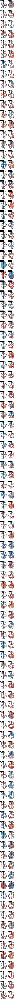

In [8]:
plot_first_level_contrast(all_contrasts, 'zscore', 3)

# Second level analysis

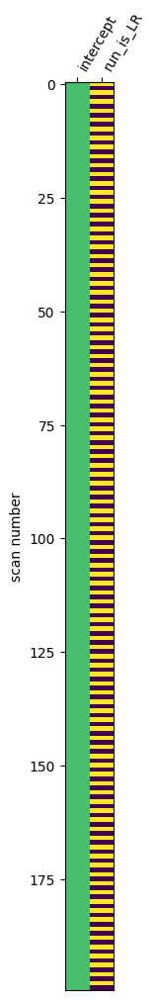

In [ ]:
from nilearn.glm.second_level import SecondLevelModel
from nilearn.plotting import plot_design_matrix

# Collect beta maps (parameter estimates) for each subject
beta_maps = []
run_is_LR = []
for sub in all_contrasts:
    for run in all_contrasts[sub]:
        beta_maps.append(all_contrasts[sub][run]['effectsize'])
        if run=='LR':
            run_is_LR.append(1)
        else:
            run_is_LR.append(0)

# Make a design matrix
# Include the type of run (LR vs RL, but only one because they are collinear)
second_level_design = pd.DataFrame(
    np.transpose([[1]*len(beta_maps), run_is_LR]),
    columns=['intercept', 'run_is_LR']
)
plot_design_matrix(second_level_design)
second_level_model = SecondLevelModel().fit(beta_maps, design_matrix=second_level_design)


Compute the contrast and visualize it on slices

d:\GitHub\HCP-FMRI\.venv\Lib\site-packages\numpy\_core\fromnumeric.py:867: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)
C:\Users\Abry\AppData\Local\Temp\ipykernel_22928\537072388.py:5: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  view_img(second_level_contrast['z_score'], threshold=3)



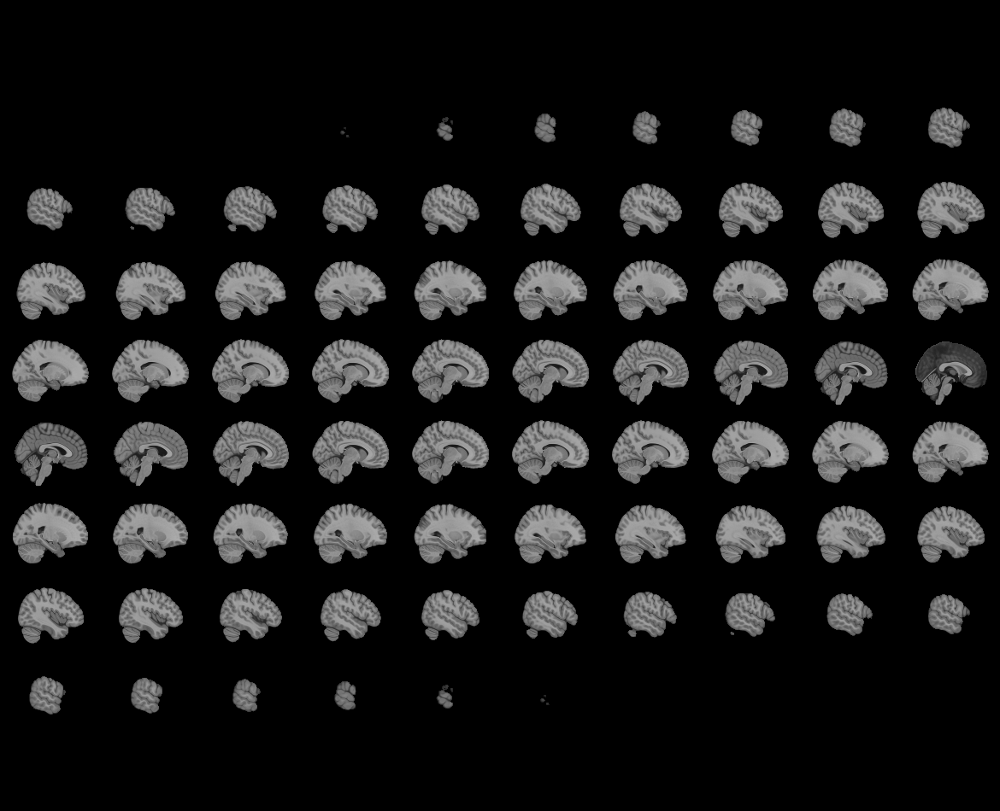
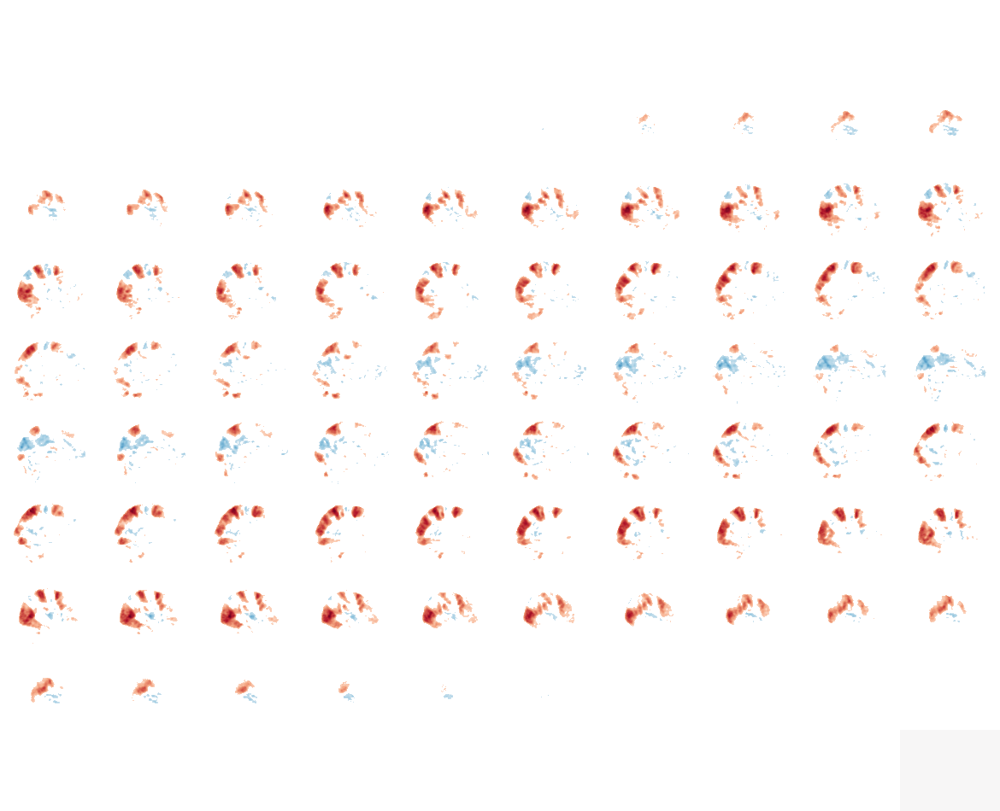

In [168]:
second_level_contrast = second_level_model.compute_contrast(
    second_level_contrast="intercept",
    output_type="all",
)
view_img(second_level_contrast['z_score'], threshold=3)

Visualize the contrast on a surface

In [169]:
view_img_on_surf(second_level_contrast['z_score'], title='z-scored mental vs random contrast (without confounds)')

C:\Users\Abry\AppData\Local\Temp\ipykernel_22928\3586537333.py:1: DeprecationWarning: The `darkness` parameter will be deprecated in release 0.13. We recommend setting `darkness` to None
  view_img_on_surf(second_level_contrast['z_score'], title='z-scored mental vs random contrast (without confounds)')
C:\Users\Abry\AppData\Local\Temp\ipykernel_22928\3586537333.py:1: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  view_img_on_surf(second_level_contrast['z_score'], title='z-scored mental vs random contrast (without confounds)')


### Second level analysis incorporating behavioral confounds

Collect confounds

In [148]:
behavior_file = 'hcp_behavior_unfiltered.csv'

subject_list = get_subject_list(subjects_dir)

behavior_unfiltered = pd.read_csv(behavior_file).rename(columns={'Subject': 'subject',
                                                                 'Gender': 'gender',
                                                                 'Age': 'age'})
behavior_unfiltered['subject'] = behavior_unfiltered['subject'].astype(str)
behavior_unfiltered = behavior_unfiltered[ behavior_unfiltered['subject'].isin(subject_list)]

#behavior = behavior_unfiltered[['subject','NEOFAC_A','NEOFAC_C','NEOFAC_N','NEOFAC_O','NEOFAC_E']]
confounds = behavior_unfiltered[['subject']]
confounds['gender'] = behavior_unfiltered['gender'].map({'M': 0, 'F': 1})
confounds['age_22_25'] = (behavior_unfiltered['age'] == '22-25')*1
confounds['age_26_30'] = (behavior_unfiltered['age'] == '26-30')*1
confounds['age_31_35'] = (behavior_unfiltered['age'] == '31-35')*1
confounds['age_36_plus'] = (behavior_unfiltered['age'] == '36+')*1
confounds.head()

C:\Users\Abry\AppData\Local\Temp\ipykernel_22928\561586388.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  confounds['gender'] = behavior_unfiltered['gender'].map({'M': 0, 'F': 1})
C:\Users\Abry\AppData\Local\Temp\ipykernel_22928\561586388.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  confounds['age_22_25'] = (behavior_unfiltered['age'] == '22-25')*1
C:\Users\Abry\AppData\Local\Temp\ipykernel_22928\561586388.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

,subject,gender,age_22_25,age_26_30,age_31_35,age_36_plus
2,100307,1,0,1,0,0
3,100408,0,0,0,1,0
6,101107,0,1,0,0,0
8,101309,0,0,1,0,0
11,101915,1,0,0,1,0


Create the design matrix

<Axes: label='conditions', ylabel='scan number'>

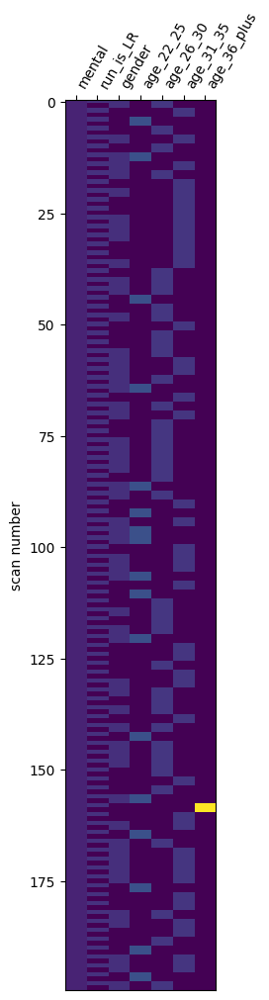

In [164]:
beta_maps = []
fmri = {'subject': [], 'mental': [], 'run_is_LR': []}
for sub in all_contrasts:   
    for run in all_contrasts[sub]:
        beta_maps.append(all_contrasts[sub][run]['effectsize'])
        fmri['subject'].append(sub)
        fmri['mental'].append(1)
        if run=='LR':
            fmri['run_is_LR'].append(1)
        else:
            fmri['run_is_LR'].append(0)
fmri = pd.DataFrame(fmri)

second_level_design_with_confounds = pd.merge(fmri, confounds, on='subject').drop('subject',axis=1)
plot_design_matrix(second_level_design_with_confounds)


Fit the model

In [152]:
second_level_with_confounds = SecondLevelModel().fit(beta_maps, design_matrix=second_level_design_with_confounds)

Compute and show the mental vs random contrast

In [165]:
contrast = second_level_with_confounds.compute_contrast(
    second_level_contrast='mental',
    output_type='z_score')
view_img_on_surf(contrast, title='z-scored mental vs random contrast (with confounds)')

C:\Users\Abry\AppData\Local\Temp\ipykernel_22928\4262725085.py:4: DeprecationWarning: The `darkness` parameter will be deprecated in release 0.13. We recommend setting `darkness` to None
  view_img_on_surf(contrast, title='z-scored mental vs random contrast (with confounds)')
C:\Users\Abry\AppData\Local\Temp\ipykernel_22928\4262725085.py:4: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  view_img_on_surf(contrast, title='z-scored mental vs random contrast (with confounds)')


# Parcellation of the results

In [156]:
glasser_labels = [line.strip() for line in open(glasser_labels_file, 'r')]

Get parameter estimates for the Mental vs Random contrast for EVERY REGION of the Glasser atlas

In [ ]:
glasser_masker = NiftiLabelsMasker(labels_img=glasser_parcellation_file,
                                   standarize=False,
                                   reports=False)


contrast_values_list = []

stat = 'effectsize'
for sub in all_contrasts:
    for run in all_contrasts[sub]:
        print(f'Processing subject {sub}, run {run}')
        subj_contrasts = glasser_masker.fit_transform(all_contrasts[sub][run][stat])
        for idx in range(len(subj_contrasts)):
            contrast_values_list.append([sub, run, glasser_labels[idx], subj_contrasts[idx]])


contrast_values_df = pd.DataFrame(contrast_values_list, columns=['subject', 'run', 'region', stat])
contrast_values_df.to_csv('GLM_nilearn/1st_level/contrasts_MentalVsRandom/grand_mean_scaling/glasser_contrast_values.csv', index=False)

Processing subject 100307, run LR
Processing subject 100307, run RL
Processing subject 100408, run LR
Processing subject 100408, run RL
Processing subject 101107, run LR
Processing subject 101107, run RL
Processing subject 101309, run LR
Processing subject 101309, run RL
Processing subject 101915, run LR
Processing subject 101915, run RL
Processing subject 103111, run LR
Processing subject 103111, run RL
Processing subject 103414, run LR
Processing subject 103414, run RL
Processing subject 103818, run LR
Processing subject 103818, run RL
Processing subject 105014, run LR
Processing subject 105014, run RL
Processing subject 105115, run LR
Processing subject 105115, run RL
Processing subject 106016, run LR
Processing subject 106016, run RL
Processing subject 108828, run LR
Processing subject 108828, run RL
Processing subject 110411, run LR
Processing subject 110411, run RL
Processing subject 111312, run LR
Processing subject 111312, run RL
Processing subject 111716, run LR
Processing sub

Construct custom regions combining regions from the Glasser parcellation

In [171]:
glasser_parcellation = load_img(glasser_parcellation_file)

glasser_labels = [reg.replace('Right_', 'R_').replace('Left_', 'L_') for reg in glasser_labels]

# Define Regions Of Interest
### OLD LABELS
'''mpfc_labels_R = ['R_10r', 'R_9m', 'R_9p', 'R_10d', 'R_p9-46v', 'R_a9-46v', 'R_9-46d', 'R_9a', 'R_10v', 'R_a10p', 'R_10pp', 'R_p10p']
mpfc_labels_L = ['L_10r', 'L_9m', 'L_9p', 'L_10d', 'L_p9-46v', 'L_a9-46v', 'L_9-46d', 'L_9a', 'L_10v', 'L_a10p', 'L_10pp', 'L_p10p']
mpfc_labels = mpfc_labels_R + mpfc_labels_L 
tpj_labels_R = ['R_PGp', 'R_PFm', 'R_PGi', 'R_PGs']
tpj_labels_L = [ 'L_PGp', 'L_PFm', 'L_PGi', 'L_PGs']
tpj_labels = tpj_labels_R + tpj_labels_L
pcc_labels_R = ['R_23d', 'R_v23ab', 'R_d23ab', 'R_31pv', 'R_23c', 'R_31pd', 'R_31a']
pcc_labels_L = ['L_23d', 'L_v23ab', 'L_d23ab', 'L_31pv', 'L_23c', 'L_31pd', 'L_31a']
pcc_labels = pcc_labels_R + pcc_labels_L'''

### NEW LABELS
mpfc = '33pr, p24pr, p24, a24, p32pr, a32pr, d32, s32, 8BM, 9m, 10v, 10r, 25'.split(', ')
tpj = 'TPOJ1, TPOJ2, TPOJ3, STV, PSL'.split(', ')
pcc = 'DVT, ProS, POS1, POS2, RSC, v23ab, d23ab, 31pv, 31pd, 31a, 23d, 23c, PCV, 7m'.split(', ')


mpfc_labels_R = ['R_'+reg for reg in mpfc]
mpfc_labels_L = ['L_'+reg for reg in mpfc]
mpfc_labels = mpfc_labels_R + mpfc_labels_L 
tpj_labels_R = ['R_'+reg for reg in tpj]
tpj_labels_L = ['L_'+reg for reg in tpj]
tpj_labels = tpj_labels_R + tpj_labels_L
pcc_labels_R = ['R_'+reg for reg in pcc]
pcc_labels_L = ['L_'+reg for reg in pcc]
pcc_labels = pcc_labels_R + pcc_labels_L



# Find the label values to extract the regions from the parcellation
mpfc_idx = [glasser_labels.index(label) for label in mpfc_labels]
mpfc_R_idx = [glasser_labels.index(label) for label in mpfc_labels_R]
mpfc_L_idx = [glasser_labels.index(label) for label in mpfc_labels_L]

tpj_idx = [glasser_labels.index(label) for label in tpj_labels]
tpj_R_idx = [glasser_labels.index(label) for label in tpj_labels_R]
tpj_L_idx = [glasser_labels.index(label) for label in tpj_labels_L]

pcc_idx = [glasser_labels.index(label) for label in pcc_labels]
pcc_R_idx = [glasser_labels.index(label) for label in pcc_labels_R]
pcc_L_idx = [glasser_labels.index(label) for label in pcc_labels_L]



def filter_parcellation(parcellation_img, keep_these_values):
    fdata = parcellation_img.get_fdata()
    mask = np.isin(fdata, keep_these_values).astype(np.int32)
    return new_img_like(parcellation_img, mask)

mpfc_mask = filter_parcellation(glasser_parcellation, mpfc_idx)
mpfc_R_mask = filter_parcellation(glasser_parcellation, mpfc_R_idx)
mpfc_L_mask = filter_parcellation(glasser_parcellation, mpfc_L_idx)

tpj_mask = filter_parcellation(glasser_parcellation, tpj_idx)
tpj_R_mask = filter_parcellation(glasser_parcellation, tpj_R_idx)
tpj_L_mask = filter_parcellation(glasser_parcellation, tpj_L_idx)

pcc_mask = filter_parcellation(glasser_parcellation, pcc_idx)
pcc_R_mask = filter_parcellation(glasser_parcellation, pcc_R_idx)
pcc_L_mask = filter_parcellation(glasser_parcellation, pcc_L_idx)

'''plot_roi(mpfc_R_mask, title='Right MPFC')
plot_roi(mpfc_L_mask, title='Left MPFC')

plot_roi(tpj_mask, title='Bilateral TPJ')
plot_roi(tpj_R_mask, title='Right TPJ')
plot_roi(tpj_L_mask, title='Left TPJ')

plot_roi(pcc_mask, title='Bilateral PCC')
plot_roi(pcc_R_mask, title='Right PCC')
plot_roi(pcc_L_mask, title='Left PCC')'''

#view_img_on_surf(mpfc_mask, title='Bilateral MPFC')



"plot_roi(mpfc_R_mask, title='Right MPFC')\nplot_roi(mpfc_L_mask, title='Left MPFC')\n\nplot_roi(tpj_mask, title='Bilateral TPJ')\nplot_roi(tpj_R_mask, title='Right TPJ')\nplot_roi(tpj_L_mask, title='Left TPJ')\n\nplot_roi(pcc_mask, title='Bilateral PCC')\nplot_roi(pcc_R_mask, title='Right PCC')\nplot_roi(pcc_L_mask, title='Left PCC')"

In [170]:
#view_img_on_surf(mpfc_mask, surf_mesh='fsaverage', black_bg=True)
#view_img_on_surf(tpj_mask, surf_mesh='fsaverage', black_bg=True)
#view_img_on_surf(pcc_mask, surf_mesh='fsaverage', black_bg=True)

In [172]:
#view_img(mpfc_mask)
#view_img(tpj_mask)
#view_img(pcc_mask)

In [146]:
mpfc_masker = NiftiLabelsMasker(labels_img=mpfc_mask, standarize=False, reports=False)
mpfc_R_masker = NiftiLabelsMasker(labels_img=mpfc_R_mask, standarize=False, reports=False)
mpfc_L_masker = NiftiLabelsMasker(labels_img=mpfc_L_mask, standarize=False, reports=False)

tpj_masker = NiftiLabelsMasker(labels_img=tpj_mask, standarize=False, reports=False)
tpj_R_masker = NiftiLabelsMasker(labels_img=tpj_R_mask, standarize=False, reports=False)
tpj_L_masker = NiftiLabelsMasker(labels_img=tpj_L_mask, standarize=False, reports=False)

pcc_masker = NiftiLabelsMasker(labels_img=pcc_mask, standarize=False, reports=False)
pcc_R_masker = NiftiLabelsMasker(labels_img=pcc_R_mask, standarize=False, reports=False)
pcc_L_masker = NiftiLabelsMasker(labels_img=pcc_L_mask, standarize=False, reports=False)


contrast_values_list = []

stat = 'effectsize'
for sub in all_contrasts:
    for run in all_contrasts[sub]:
        print(f'Processing subject {sub}, run {run}')

        contrast_values_list.append([sub, run, 'MPFC', mpfc_masker.fit_transform(all_contrasts[sub][run][stat])])
        contrast_values_list.append([sub, run, 'MPFC_Right', mpfc_R_masker.fit_transform(all_contrasts[sub][run][stat])])
        contrast_values_list.append([sub, run, 'MPFC_Left', mpfc_L_masker.fit_transform(all_contrasts[sub][run][stat])])

        contrast_values_list.append([sub, run, 'TPJ', tpj_masker.fit_transform(all_contrasts[sub][run][stat])])
        contrast_values_list.append([sub, run, 'TPJ_Right', tpj_R_masker.fit_transform(all_contrasts[sub][run][stat])])
        contrast_values_list.append([sub, run, 'TPJ_Left', tpj_L_masker.fit_transform(all_contrasts[sub][run][stat])])

        contrast_values_list.append([sub, run, 'PCC', pcc_masker.fit_transform(all_contrasts[sub][run][stat])])
        contrast_values_list.append([sub, run, 'PCC_Right', pcc_R_masker.fit_transform(all_contrasts[sub][run][stat])])
        contrast_values_list.append([sub, run, 'PCC_Left', pcc_L_masker.fit_transform(all_contrasts[sub][run][stat])])

contrast_values_df = pd.DataFrame(contrast_values_list, columns=['subject', 'run', 'region', stat])
contrast_values_df.to_csv('GLM_nilearn/1st_level/contrasts_MentalVsRandom/grand_mean_scaling/our_regions_contrast_values.csv', index=False)

Processing subject 100307, run LR
Processing subject 100307, run RL
Processing subject 100408, run LR
Processing subject 100408, run RL
Processing subject 101107, run LR
Processing subject 101107, run RL
Processing subject 101309, run LR
Processing subject 101309, run RL
Processing subject 101915, run LR
Processing subject 101915, run RL
Processing subject 103111, run LR
Processing subject 103111, run RL
Processing subject 103414, run LR
Processing subject 103414, run RL
Processing subject 103818, run LR
Processing subject 103818, run RL
Processing subject 105014, run LR
Processing subject 105014, run RL
Processing subject 105115, run LR
Processing subject 105115, run RL
Processing subject 106016, run LR
Processing subject 106016, run RL
Processing subject 108828, run LR
Processing subject 108828, run RL
Processing subject 110411, run LR
Processing subject 110411, run RL
Processing subject 111312, run LR
Processing subject 111312, run RL
Processing subject 111716, run LR
Processing sub

In [145]:
contrast_values_df

,subject,run,region,effectsize
0,100307,LR,MPFC,-0.07032747820948518
1,100307,LR,MPFC_Right,-0.06259533201740992
2,100307,LR,MPFC_Left,-0.07782727676195939
3,100307,LR,TPJ,-0.008169443864933668
4,100307,LR,TPJ_Right,-0.00281829938598166
5,100307,LR,TPJ_Left,-0.012657911274405666
6,100307,LR,PCC,-0.13213860473496228
7,100307,LR,PCC_Right,-0.15359892484201307
8,100307,LR,PCC_Left,-0.11049416367370457
